# Signal processing

In [37]:
import numpy as np
import matplotlib.pyplot as plt
import datetime as datetime
import os
import scipy
import scipy.signal as signal


In [38]:
path = "F:\\interferometry_data\\data_20_03_to_11_05"           # Path to the data folder
path_save_fig = "F:\\interferometry_data\\image_610mhz"         # Path to save the figures

# Get list of folder names from data path
data_folder_list = os.listdir(path)
number_folder = len(data_folder_list)

# Sort the folder names
data_folder_list.sort()
data_folder_list


['2025_03_20',
 '2025_03_21',
 '2025_03_22',
 '2025_03_23',
 '2025_03_24',
 '2025_03_25',
 '2025_03_26',
 '2025_03_27',
 '2025_03_28',
 '2025_03_29',
 '2025_03_30',
 '2025_03_31',
 '2025_04_01',
 '2025_04_02',
 '2025_04_03',
 '2025_04_04',
 '2025_04_05',
 '2025_04_06',
 '2025_04_07',
 '2025_04_08',
 '2025_04_09',
 '2025_04_10',
 '2025_04_11',
 '2025_04_12',
 '2025_04_13',
 '2025_04_14',
 '2025_04_15',
 '2025_04_16',
 '2025_04_17',
 '2025_04_18',
 '2025_04_19',
 '2025_04_20',
 '2025_04_21',
 '2025_04_22',
 '2025_04_23',
 '2025_04_24',
 '2025_04_25',
 '2025_04_26',
 '2025_04_27']

In [39]:
def get_folder_file_list(path, folder):

    _file_list = os.listdir(path + '\\' + folder)
    _file_list.sort()

    _number_file = 0
    _file_index = 0

    for file in _file_list:
        if  file < str(f"{folder}_10_00_00_PSD.csv"):
            _file_index += 1
            continue
        elif file > str(f"{folder}_14_00_00_PSD.csv"):
            continue
        
        _number_file += 1

    _frequency =  np.loadtxt(os.path.join(path + '\\' + folder, _file_list[0]), delimiter=',')[:,0]

    _timeStamp_list = np.zeros(_number_file)
    _timeString_list = ["" for i in range(_number_file)]

    for file in _file_list:
        if  file < str(f"{folder}_10_00_00_PSD.csv") or file > str(f"{folder}_14_00_00_PSD.csv"):
            continue

        # Split the string into its components
        components = file.split("_")
        # Extract the date and time components
        date_str = f"{components[0]}-{components[1]}-{components[2]}"
        time_str = f"{components[3]}:{components[4]}:{components[5]}"
        _timeString_list[_file_list.index(file) - _file_index] = time_str
        # Combine the date and time components into a single string
        dateTime_str = f"{date_str} {time_str}"
        
        # Parse the string into a datetime object
        dateTime = datetime.datetime.strptime(dateTime_str, '%Y-%m-%d %H:%M:%S')
        _timeStamp_list[_file_list.index(file) - _file_index] = dateTime.timestamp()

    return _file_list, _frequency, _timeStamp_list, _timeString_list, _number_file

In [40]:
def calculate_power(path, folder, file_list, number_file, Frequency):

    power_list = np.zeros(number_file)
    data_matrix = np.zeros((len(Frequency), number_file))

    _file_index = 0

    for file in file_list:
        if  file < str(f"{folder}_10_00_00_PSD.csv"):
            _file_index += 1

    for file in file_list:

        if  file < str(f"{folder}_10_00_00_PSD.csv") or file > str(f"{folder}_14_00_00_PSD.csv"):
            continue

        data = np.loadtxt(os.path.join(path + "\\" + folder, file), delimiter=',')
        data_matrix[:, file_list.index(file) - _file_index] = data[:, 1]
        power_list[file_list.index(file) - _file_index] = data[:, 1].mean()

    return power_list, data_matrix

In [ ]:
def plot_graph(time_list, power_list, date):
    fig, ax = plt.subplots(1, 1, figsize = [24, 8])
    ax.set_title(f'Interferometry 610MHz at Hoa Lac - Ha Noi - {date}', fontsize=20)
    ax.set(xlabel = 'Time(s)', ylabel = 'Signal(dB)')
    ax.grid()
    ax.plot(time_list, power_list, color = 'green', linestyle = '-')

    x = np.arange(0, len(time_list))
    plt.xticks(x[::len(time_list)//25], time_list[::len(time_list)//25], rotation=45, ha='right')
    plt.autoscale()
    plt.show()

    fig.savefig(f"{path_save_fig}\\avg_power\\interferometry_610MHz_{date}.png", dpi=600, bbox_inches='tight')
    return

In [42]:
def remove_spike(x, threshold=3, window_size=11):
    """
    Remove spikes from the x-axis.

    Parameters:
    x (numpy array): The x-axis to remove spikes from.
    threshold (float): The threshold to define spikes. Default value is 3.
    window_size (int): The size of the window to calculate the average. Default value is 11.

    Returns:
    x_smooth (numpy array): The x-axis with spikes removed.
    """
    # Calculate the mean of x
    x_mean = np.mean(x)

    # Calculate the standard deviation of x
    x_std = np.std(x)

    # Finding the indices of spikes
    spike = np.abs(x - x_mean) > threshold * x_std

    # Removing the spike
    x_smooth = np.copy(x)
    x_smooth[spike] = np.mean(x[~spike])

    # Using linear interpolation
    # x_smooth[spike] = np.interp(np.where(spike)[0], np.where(~spike)[0], x[~spike])           # Bad

    # Using Savitzky-Golay filter
    # x_smooth = signal.savgol_filter(x_smooth, window_size, 3)                                 # Dependence on Threshold

    # Using convolution
    x_smooth = np.convolve(x, np.ones(window_size)/window_size, mode='same')                    # Good

    return x_smooth


In [ ]:
def plot_histogram(data_matrix, Frequency, time_list, date):
    fig, ax = plt.subplots(1, 1, figsize = [24, 8], layout = 'constrained')
    ax.set_title(f'Interferometry 610MHz at Hoa Lac - Ha Noi - {date}', fontsize=20)
    ax.set_xlabel('Time(hh:mm:ss) UTC+07', fontsize=16)
    ax.set_ylabel('Frequency(MHz)', fontsize=16)
    plt.imshow(data_matrix, cmap = 'inferno', interpolation = 'nearest', aspect = 'auto', origin = 'lower')
    x = np.arange(0, len(time_list))
    plt.xticks(x[::len(time_list)//50], time_list[::len(time_list)//50], rotation=45, ha='right')
    y = np.arange(0, 512)
    plt.yticks(y[::len(Frequency)//8], Frequency[::len(Frequency)//8], rotation=0, ha='right')
    plt.colorbar()
    fig.savefig(f'{path_save_fig}\\histogram\\Interferometry_610MHz_at_Hoa_Lac_Ha_Noi_{date}.png', dpi=600, bbox_inches='tight')
    plt.show()

In [44]:
# mean_power_matrix = np.zeros((1433, number_folder))

# for folder in data_folder_list:
    # number_file = 0

    # file_list, Frequency, timeStamp_list, timeString_list, number_file = get_folder_file_list(path, folder)
    # power_list, data_matrix = calculate_power(path, folder, file_list, number_file, Frequency)

    # remove_spike(power_list, threshold=3, window_size=21)
    # np.savetxt(os.path.join(path, f'mean_power.csv'), np.c_[power_list], delimiter=',', fmt='%f')

    # mean_power_matrix[:, data_folder_list.index(folder)] = power_list

    # Plot the graph and histogram
    # plot_graph(timeString_list, power_list, folder)
    # plot_histogram(data_matrix, Frequency, timeString_list, folder)



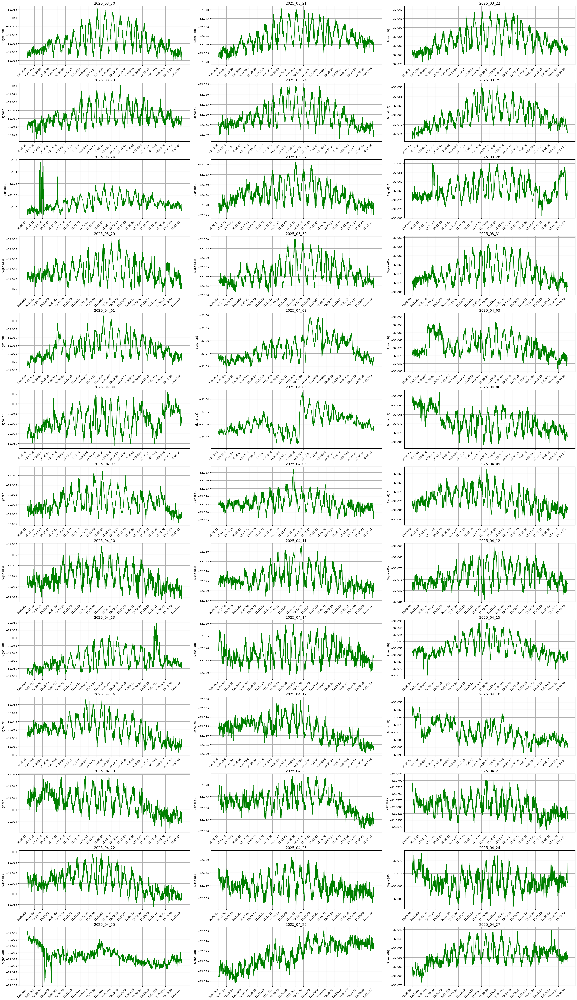

In [45]:
fig, ax_graph = plt.subplots(13, 3, figsize = [30, 52], layout = 'constrained')

counter = 0

for folder in data_folder_list:
    file_list, Frequency, timeStamp_list, timeString_list, number_file = get_folder_file_list(path, folder)
    power_list, data_matrix = calculate_power(path, folder, file_list, number_file, Frequency)

    ax_graph[(int)(counter / 3)][counter % 3].set(ylabel = 'Signal(dB)')
    ax_graph[(int)(counter / 3)][counter % 3].grid()
    ax_graph[(int)(counter / 3)][counter % 3].plot(timeString_list, power_list, color = 'green', linestyle = '-')
    ax_graph[(int)(counter / 3)][counter % 3].set_title(f'{folder}', fontsize=13)

    x = np.arange(0, len(timeString_list))
    ax_graph[(int)(counter / 3)][counter % 3].set_xticks(x[::len(timeString_list)//20])
    ax_graph[(int)(counter / 3)][counter % 3].set_xticklabels(timeString_list[::len(timeString_list)//20], rotation=45, ha='right')

    counter += 1

plt.show()

In [46]:
fig, ax_graph = plt.subplots(13, 3, figsize = [30, 52], layout = 'constrained')

counter = 0

for folder in data_folder_list:
    file_list, Frequency, timeStamp_list, timeString_list, number_file = get_folder_file_list(path, folder)
    power_list, data_matrix = calculate_power(path, folder, file_list, number_file, Frequency)

    ax_graph[(int)(counter / 3)][counter % 3].set(ylabel = 'Signal(dB)')
    ax_graph[(int)(counter / 3)][counter % 3].imshow(data_matrix, cmap = 'inferno', interpolation = 'nearest', aspect = 'auto', origin = 'lower')
    ax_graph[(int)(counter / 3)][counter % 3].set_title(f'{folder}', fontsize=13)

    x = np.arange(0, len(timeString_list))
    ax_graph[(int)(counter / 3)][counter % 3].set_xticks(x[::len(timeString_list)//20])
    ax_graph[(int)(counter / 3)][counter % 3].set_xticklabels(timeString_list[::len(timeString_list)//20], rotation=45, ha='right')

    y = np.arange(0, 512)
    ax_graph[(int)(counter / 3)][counter % 3].set_yticks(y[::len(Frequency)//8])
    ax_graph[(int)(counter / 3)][counter % 3].set_yticklabels(Frequency[::len(Frequency)//8], rotation=0, ha='right')

    counter += 1

plt.show()

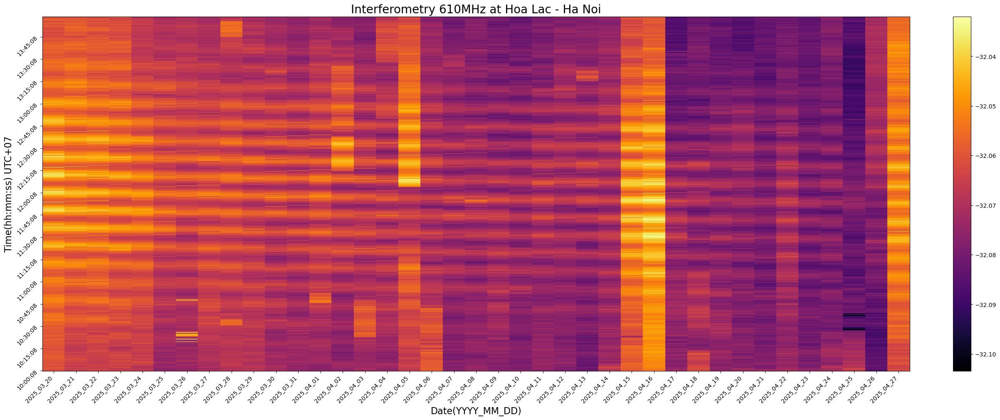

In [48]:
mean_power_matrix = np.zeros((1433, number_folder))

for folder in data_folder_list:
    number_file = 0

    file_list, Frequency, timeStamp_list, timeString_list, number_file = get_folder_file_list(path, folder)
    power_list, data_matrix = calculate_power(path, folder, file_list, number_file, Frequency)

    mean_power_matrix[:, data_folder_list.index(folder)] = power_list

fig, ax = plt.subplots(1, 1, figsize = [24, 10], layout = 'constrained')
ax.set_title(f'Interferometry 610MHz at Hoa Lac - Ha Noi', fontsize=20)
ax.set_xlabel('Date(YYYY_MM_DD)', fontsize=16)
ax.set_ylabel('Time(hh:mm:ss) UTC+07', fontsize=16)
plt.imshow(mean_power_matrix, cmap = 'inferno', interpolation = 'nearest', aspect = 'auto', origin = 'lower')
x = np.arange(0, len(data_folder_list))
plt.xticks(x[::len(data_folder_list)//39], data_folder_list[::len(data_folder_list)//39], rotation=45, ha='right')

# Create a list of time strings from the timestamps from 10_00_00 to 14_00_00
# Use the first and last timestamps in timeStamp_list to generate the range
step_seconds = 10  # in seconds
start_ts = timeStamp_list[0]
end_ts = timeStamp_list[-1]
time_list = []
current_ts = start_ts
while current_ts <= end_ts:
    time_list.append(datetime.datetime.fromtimestamp(current_ts).strftime('%H:%M:%S'))
    current_ts += step_seconds

y = np.arange(0, len(time_list))
plt.yticks(y[::len(time_list)//16], time_list[::len(time_list)//16], rotation=45, ha='right')
plt.colorbar()
plt.show()


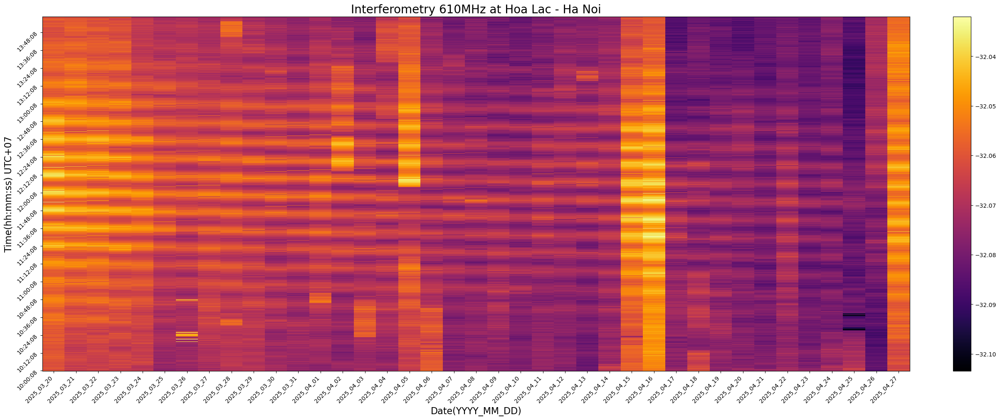

In [49]:

fig, ax = plt.subplots(1, 1, figsize = [24, 10], layout = 'constrained')
ax.set_title(f'Interferometry 610MHz at Hoa Lac - Ha Noi', fontsize=20)
ax.set_xlabel('Date(YYYY_MM_DD)', fontsize=16)
ax.set_ylabel('Time(hh:mm:ss) UTC+07', fontsize=16)
plt.imshow(mean_power_matrix, cmap = 'inferno', interpolation = 'nearest', aspect = 'auto', origin = 'lower')
x = np.arange(0, len(data_folder_list))
plt.xticks(x[::len(data_folder_list)//39], data_folder_list[::len(data_folder_list)//39], rotation=45, ha='right')

# Create a list of time strings from the timestamps from 10_00_00 to 14_00_00
# Use the first and last timestamps in timeStamp_list to generate the range
step_seconds = 10  # in seconds
start_ts = timeStamp_list[0]
end_ts = timeStamp_list[-1]
time_list = []
current_ts = start_ts
while current_ts <= end_ts:
    time_list.append(datetime.datetime.fromtimestamp(current_ts).strftime('%H:%M:%S'))
    current_ts += step_seconds

y = np.arange(0, len(time_list))
plt.yticks(y[::len(time_list)//20], time_list[::len(time_list)//20], rotation=45, ha='right')
plt.colorbar()
plt.show()
